# EDA Obesity


In [1]:
# Librerías

from pathlib import Path

import pandas as pd
import numpy as np

# EDA Reporting
from ydata_profiling import ProfileReport

import matplotlib.pyplot as plt
import seaborn as sns
import altair as alt # importar altair con el alias alt

# Funciones propias
import data_common_functions as dcf
import char_common_functions as ccf

In [2]:
def divide_by_gender(df, val):

    query = f"gender == '{val}'"

    df = df.query(query)
        
    return df

In [3]:
# Genera un reporte EDA para un dataframe

def profiling_report(df, title):

    profile = ProfileReport(df, title=title)

    profile.to_file(f"{title}.html")

## Main

In [4]:
# Leemos el archivo
CURRENT_DIR = Path.cwd()

BASE_DIR = Path(CURRENT_DIR).parent

df_obesity = pd.read_parquet(f"{BASE_DIR}/data/out/obesity.parquet", engine='fastparquet')

df_obesity

,age,age_range,gender,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_bmi_txt,obesity_cc,obesity_cc_txt,obesity_rcc,obesity_rcc_txt,obesity_ict,obesity_ict_txt,risk_factors
1,47.0,46-55,male,187.1980,156.630,138.5062,142.1892,1,44.696399,0.974098,0.739891,3,3-Obesidad,1,1-Alto,1,1-Medio,3,3-Obesidad,4
2,50.0,46-55,male,180.5940,98.064,98.3996,109.9058,1,30.067891,0.895309,0.544866,3,3-Obesidad,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
3,28.0,26-35,male,182.7022,89.211,97.0026,107.0102,1,26.725809,0.906480,0.530933,2,2-Sobrepeso,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
4,52.0,46-55,male,185.9026,113.273,105.9942,111.0996,1,32.775964,0.954047,0.570160,3,3-Obesidad,1,1-Alto,1,1-Medio,2,2-Sobrepeso,4
5,50.0,46-55,male,183.1086,108.279,104.0892,112.3950,1,32.294365,0.926102,0.568456,3,3-Obesidad,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4460,35.0,26-35,female,152.8064,49.259,61.5950,93.0910,0,21.096116,0.661664,0.403092,1,1-Normal,0,0-Bajo,0,0-Bajo,0,0-Delgado,0
4461,40.0,36-45,female,168.6052,67.646,73.8124,100.4062,0,23.795794,0.735138,0.437782,1,1-Normal,0,0-Bajo,0,0-Bajo,1,1-Normal,0
4462,23.0,17-25,female,168.5036,73.775,78.0034,109.7026,0,25.983093,0.711044,0.462918,2,2-Sobrepeso,0,0-Bajo,0,0-Bajo,1,1-Normal,1
4463,24.0,17-25,male,170.5102,65.149,75.7936,97.7900,1,22.408203,0.775065,0.444511,1,1-Normal,0,0-Bajo,0,0-Bajo,1,1-Normal,0


In [5]:
df_obesity.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000
mean,37.764312,170.937562,75.205328,84.701265,103.513457,0.471783,25.608337,0.816921,0.495404,1.598871,0.345824,0.272009,1.403837,1.383521
std,12.786156,10.387864,18.419132,13.362246,10.273928,0.499260,5.288433,0.085733,0.071842,0.777331,0.475690,0.589520,0.765085,1.525385
min,17.500000,124.790200,37.332420,55.702200,80.010000,0.000000,15.263630,0.583295,0.334210,0.000000,0.000000,0.000000,0.000000,0.000000
25%,26.400000,163.322000,61.957380,75.006200,96.697800,0.000000,21.940406,0.752614,0.445829,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,170.408600,72.186000,83.007200,101.904800,0.000000,24.498035,0.820929,0.482352,1.000000,0.000000,0.000000,1.000000,1.000000
75%,48.000000,177.901600,84.898000,92.278200,108.102400,1.000000,27.973753,0.876377,0.530471,2.000000,1.000000,0.000000,2.000000,3.000000
max,79.000000,218.287600,181.600000,170.205400,183.388000,1.000000,57.180160,1.153405,0.970878,3.000000,1.000000,2.000000,3.000000,4.000000


## EDA

In [6]:
profiling_report(df_obesity, 'Profile Report Obesity')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df_eda = df_obesity.copy()

In [8]:
df_eda_f = divide_by_gender(df_eda, 'female')
df_eda_f.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.0,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000
mean,37.979487,164.687163,68.229479,79.904503,104.268672,0.0,25.120005,0.764546,0.485566,1.505128,0.385897,0.391453,1.443162,1.455128
std,12.805037,7.609930,16.642426,12.974837,11.280108,0.0,5.724213,0.071123,0.077974,0.788692,0.486911,0.686842,0.865332,1.623930
min,18.000000,124.790200,37.332420,55.702200,80.010000,0.0,15.263630,0.583295,0.334210,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,159.512000,56.849880,71.170800,96.697800,0.0,21.252199,0.712801,0.431441,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,164.388800,64.676840,76.758800,102.311200,0.0,23.513015,0.757958,0.466355,1.000000,0.000000,0.000000,1.000000,1.000000
75%,48.000000,169.595800,75.365135,85.801200,109.296200,0.0,27.374036,0.805779,0.519677,2.000000,1.000000,1.000000,2.000000,3.000000
max,69.000000,194.792600,156.630000,149.809200,173.812200,0.0,57.180160,1.153405,0.875594,3.000000,1.000000,2.000000,3.000000,4.000000


In [9]:
df_eda_m = divide_by_gender(df_eda, 'male')
df_eda_m.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.0,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000
mean,37.523397,177.935617,83.015607,90.071803,102.667906,1.0,26.155082,0.875561,0.506419,1.703828,0.300957,0.138278,1.359809,1.303349
std,12.763741,8.436921,17.135835,11.637414,8.942443,0.0,4.694816,0.058367,0.062493,0.750831,0.458784,0.418023,0.631631,1.402944
min,17.500000,131.495800,45.854000,61.899800,81.102200,1.0,16.137889,0.622796,0.358646,0.000000,0.000000,0.000000,0.000000,0.000000
25%,26.000000,172.212000,70.889830,82.194400,96.697800,1.0,22.894586,0.834306,0.462974,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,177.546000,80.101490,88.290400,101.701600,1.0,25.503224,0.870376,0.497511,2.000000,0.000000,0.000000,1.000000,1.000000
75%,47.000000,183.311800,91.481000,95.707200,107.010200,1.0,28.305405,0.911671,0.536067,2.000000,1.000000,0.000000,2.000000,3.000000
max,79.000000,218.287600,181.600000,170.205400,183.388000,1.0,55.121673,1.130743,0.970878,3.000000,1.000000,2.000000,3.000000,4.000000


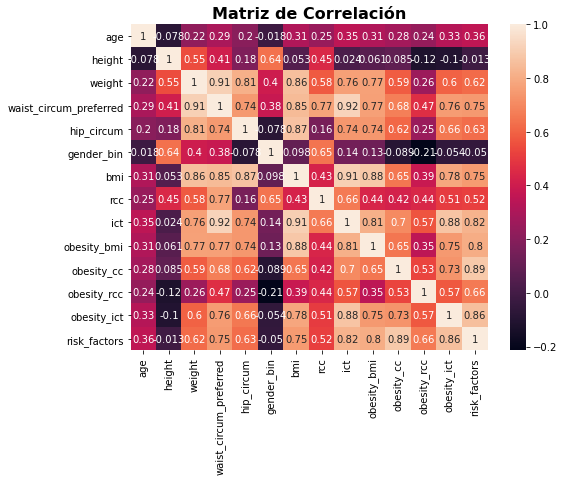

In [10]:
corr_df = df_eda.corr(method='pearson')

fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(corr_df, annot=True)
ax.set_title('Matriz de Correlación', fontsize=16, weight='bold')
plt.show()

### Preguntas para conocer mejor los datos y cómo se relacionan

La idea es también determinar qué tan pertinentes son los datos escogidos.

1. Influencia de la edad y el género en la incidencia de sobrepeso y obesidad, qué tan relacionados están esos datos. Usaremos principalmente el BMI, pero podemos estudiar también los otros indicadores.
2. ¿Cómo se relacionan BMI,ICT, RCC y CC? ¿Cuándo hablar de sobrepeso y cuándo de obesidad? 
3. ¿Cuándo hablar de riesgo de sufrir ENT?
4. Pertinencia de los indicadores calculados: Cómo deberíamos interpretar los 3 indicadores para determinar si una persona corre el riesgo de padecer sobrepeso y obesidad

### Algunas conclusiones

1. Según el BMI, el sobrepeso y la obesidad son más frecuentes en los hombres (50% percentil > 25)
2. Sin embargo, según el ICT, sólo el 25% percentil sufren de sobrepeso u obesidad (obesity_ict >= 3), sin importar el género


In [11]:
# Cantidad de personas según su clasificación por BMI, agrupadas por género y rango de edad

df_bmi = df_eda.loc[:,['gender', 'age_range', 'bmi', 'obesity_bmi_txt']]

obesity_bmi_table = pd.pivot_table(df_bmi,  index=['gender', 'age_range'],
                                            columns=['obesity_bmi_txt'],
                                            aggfunc='count',
                                            margins=True,
                                            fill_value=0)
obesity_bmi_table

bmi                                      
obesity_bmi_txt  0-Bajo Peso 1-Normal 2-Sobrepeso 3-Obesidad   All
gender age_range                                                  
female 17-25              34      398          62         25   519
       26-35              19      379         100         69   567
       36-45               6      312         114        103   535
       46-55               4      209         155        102   470
       56-65               4       92          82         66   244
       66-100              0        2           0          3     5
male   17-25              14      342         102         24   482
       26-35               3      237         186         75   501
       36-45               5      181         230         87   503
       46-55               0      100         163        109   372
       56-65               1       60         115         53   229
       66-100              0        1           2          0     3
All                       90     2313        1311        716  4430

In [12]:
# Estudio BMI

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_bmi_txt:N'

title='Cantidad de Individuos según su rango de edad y grado de Obesidad según su BMI'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total


alt.VConcatChart(...)

In [13]:
# Cantidad de personas según su clasificación por ICT, agrupadas por género y rango de edad

df_ict = df_eda.loc[:,['gender', 'age_range', 'ict', 'obesity_ict_txt']]

obesity_ict_table = pd.pivot_table(df_ict,  index=['gender', 'age_range'],
                                            columns=['obesity_ict_txt'],
                                            aggfunc='count',
                                            margins=True,
                                            fill_value=0)
obesity_ict_table

ict                                      
obesity_ict_txt  0-Delgado 1-Normal 2-Sobrepeso 3-Obesidad   All
gender age_range                                                
female 17-25            60      312         126         21   519
       26-35            94      297         133         43   567
       36-45            69      238         141         87   535
       46-55            30      176         164        100   470
       56-65            11       73          90         70   244
       66-100            0        2           1          2     5
male   17-25            39      393          46          4   482
       26-35            19      361         107         14   501
       36-45            10      311         159         23   503
       46-55             3      157         170         42   372
       56-65             0       79         128         22   229
       66-100            0        0           3          0     3
All                    335     2399        1268        428  4430

In [14]:
# Estudio ICT

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_ict_txt:N'

title='Cantidad de Individuos según su rango de edad y grado de Obesidad según su ICT'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

In [15]:
df_rcc = df_eda.loc[:,['gender', 'age_range', 'rcc', 'obesity_rcc_txt']]

obesity_rcc_table = pd.pivot_table(df_rcc,  index=['gender', 'age_range'],
                                            columns=['obesity_rcc_txt'],
                                            aggfunc='count',
                                            margins=True,
                                            fill_value=0)
obesity_rcc_table

rcc                     
obesity_rcc_txt  0-Bajo 1-Medio 2-Alto   All
gender age_range                            
female 17-25        406      81     32   519
       26-35        463      69     35   567
       36-45        393      83     59   535
       46-55        299      90     81   470
       56-65        133      46     65   244
       66-100         3       1      1     5
male   17-25        476       4      2   482
       26-35        483      13      5   501
       36-45        458      35     10   503
       46-55        274      74     24   372
       56-65        165      47     17   229
       66-100         3       0      0     3
All                3556     543    331  4430

In [16]:
# Estudio RCC

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_rcc_txt:N'

title='Cantidad de Individuos según su rango de edad y riesgo de Obesidad según su RCC'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

In [17]:
df_cc = df_eda.loc[:,['gender', 'age_range', 'waist_circum_preferred', 'obesity_cc_txt']]

obesity_cc_table = pd.pivot_table(df_cc,  index=['gender', 'age_range'],
                                            columns=['obesity_cc_txt'],
                                            aggfunc='count',
                                            margins=True,
                                            fill_value=0)
obesity_cc_table

waist_circum_preferred             
obesity_cc_txt                   0-Bajo 1-Alto   All
gender age_range                                    
female 17-25                        378    141   519
       26-35                        401    166   567
       36-45                        323    212   535
       46-55                        234    236   470
       56-65                         99    145   244
       66-100                         2      3     5
male   17-25                        437     45   482
       26-35                        395    106   501
       36-45                        336    167   503
       46-55                        184    188   372
       56-65                        107    122   229
       66-100                         2      1     3
All                                2898   1532  4430

In [18]:
# Estudio CC

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_cc_txt:N'

title='Cantidad de Individuos según su rango de edad y riesgo de Obesidad según su CC'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

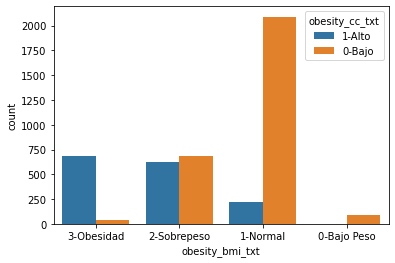

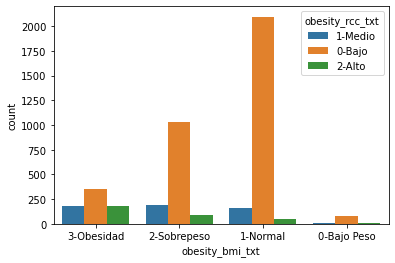

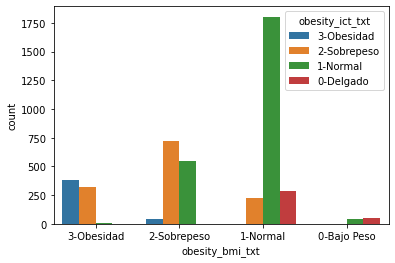

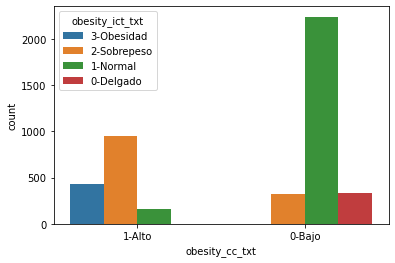

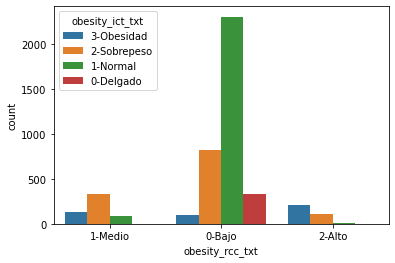

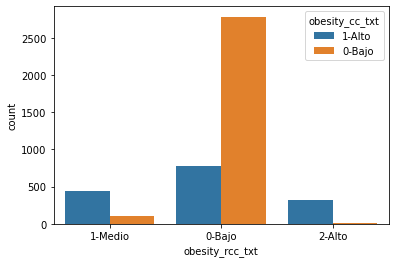

In [19]:

sns.countplot(x='obesity_bmi_txt', hue='obesity_cc_txt', data=df_obesity)
plt.show()

sns.countplot(x='obesity_bmi_txt', hue='obesity_rcc_txt', data=df_obesity)
plt.show()

sns.countplot(x='obesity_bmi_txt', hue='obesity_ict_txt', data=df_obesity)
plt.show()

sns.countplot(x='obesity_cc_txt', hue='obesity_ict_txt', data=df_obesity)
plt.show()

sns.countplot(x='obesity_rcc_txt', hue='obesity_ict_txt', data=df_obesity)
plt.show()

sns.countplot(x='obesity_rcc_txt', hue='obesity_cc_txt', data=df_obesity)
plt.show()

In [20]:
# Estudio Obesidad y riesgo de ENT (calculado)

x = 'count(*):Q'
y = 'age_range:O'
detail = 'risk_factors:N'

title='Cantidad de Individuos según su rango de edad y cantidad de factores de riesgo'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)